In [4]:
import numpy as np
import pandas as pd
from io import StringIO 
import graphviz 
import pydotplus
from typing import Dict, Tuple
from scipy import stats
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, balanced_accuracy_score, log_loss
from sklearn.metrics import confusion_matrix
from sklearn.linear_model import SGDClassifier
from sklearn.metrics import confusion_matrix, plot_confusion_matrix, ConfusionMatrixDisplay
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.model_selection import cross_val_score, cross_validate
from sklearn.svm import SVC, NuSVC, LinearSVC
from sklearn.tree import DecisionTreeClassifier, DecisionTreeRegressor, export_graphviz
from sklearn.model_selection import GridSearchCV
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import LabelEncoder
from IPython.core.display import HTML
from sklearn.tree import export_text
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.ensemble import BaggingClassifier, RandomForestClassifier, GradientBoostingClassifier
from io import StringIO
from heamy.estimator import Regressor, Classifier
from heamy.pipeline import ModelsPipeline
from heamy.dataset import Dataset
from mlxtend.classifier import StackingClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.datasets import make_classification
from gmdhpy import gmdh
from IPython.display import Image
%matplotlib inline 
sns.set(style="ticks")
import warnings
warnings.filterwarnings('ignore')

In [5]:
dataset = pd.read_csv('./Datasets/air_satisfaction.csv')
dataset.head()

,Num,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,0,19556,Female,Loyal Customer,52,Business travel,Eco,160,5,4,...,5,5,5,5,2,5,5,50,44.0,satisfied
1,1,90035,Female,Loyal Customer,36,Business travel,Business,2863,1,1,...,4,4,4,4,3,4,5,0,0.0,satisfied
2,2,12360,Male,disloyal Customer,20,Business travel,Eco,192,2,0,...,2,4,1,3,2,2,2,0,0.0,neutral or dissatisfied
3,3,77959,Male,Loyal Customer,44,Business travel,Business,3377,0,0,...,1,1,1,1,3,1,4,0,6.0,satisfied
4,4,36875,Female,Loyal Customer,49,Business travel,Eco,1182,2,3,...,2,2,2,2,4,2,4,0,20.0,satisfied


In [6]:
dataset.drop(['Num','id'], axis=1, inplace=True)
dataset.head()

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,Female,Loyal Customer,52,Business travel,Eco,160,5,4,3,4,...,5,5,5,5,2,5,5,50,44.0,satisfied
1,Female,Loyal Customer,36,Business travel,Business,2863,1,1,3,1,...,4,4,4,4,3,4,5,0,0.0,satisfied
2,Male,disloyal Customer,20,Business travel,Eco,192,2,0,2,4,...,2,4,1,3,2,2,2,0,0.0,neutral or dissatisfied
3,Male,Loyal Customer,44,Business travel,Business,3377,0,0,0,2,...,1,1,1,1,3,1,4,0,6.0,satisfied
4,Female,Loyal Customer,49,Business travel,Eco,1182,2,3,4,3,...,2,2,2,2,4,2,4,0,20.0,satisfied


In [7]:
# ищем пропуски
dataset.isna().sum()

Gender                                0
Customer Type                         0
Age                                   0
Type of Travel                        0
Class                                 0
Flight Distance                       0
Inflight wifi service                 0
Departure/Arrival time convenient     0
Ease of Online booking                0
Gate location                         0
Food and drink                        0
Online boarding                       0
Seat comfort                          0
Inflight entertainment                0
On-board service                      0
Leg room service                      0
Baggage handling                      0
Checkin service                       0
Inflight service                      0
Cleanliness                           0
Departure Delay in Minutes            0
Arrival Delay in Minutes             83
satisfaction                          0
dtype: int64

In [8]:
# удаляем строки с пропусками
dataset.dropna(subset='Arrival Delay in Minutes', axis=0, inplace=True)

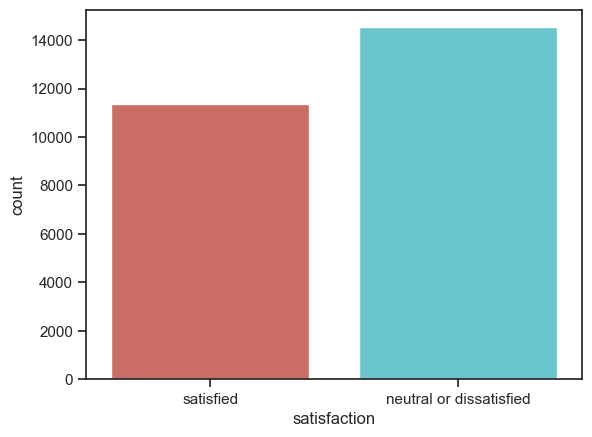

In [9]:
sns.countplot(x='satisfaction', data=dataset, palette='hls')
plt.show()

In [10]:
# кодирование признаков
le = LabelEncoder()
dataset['satisfaction']= le.fit_transform(dataset['satisfaction'])
dataset['Gender']= le.fit_transform(dataset['Gender'])
dataset['Customer Type']= le.fit_transform(dataset['Customer Type'])
dataset['Type of Travel']= le.fit_transform(dataset['Type of Travel'])
dataset['Class']= le.fit_transform(dataset['Class'])

In [11]:
# разделение на объекты-признаки и целевой признак
X = dataset.iloc[:, :-1].values 
y = dataset.iloc[:, -1].values

In [12]:
# Формирование обучающей и тестовой выборки
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 10)

In [10]:
# слуучайный лес
rf = RandomForestClassifier(n_estimators=5, oob_score=True, random_state=1).fit(X_train, y_train)

In [11]:
rf.oob_score_, 1-rf.oob_score_

(0.8823983779086608, 0.11760162209133918)

In [12]:
y_pred_test_rf = rf.predict(X_test)
y_pred_train_rf = rf.predict(X_train)
ac_rf = accuracy_score(y_train, y_pred_train_rf), accuracy_score(y_test, y_pred_test_rf)
ac_rf

(0.9943999227575553, 0.9389843599150415)

In [13]:
# Визуализация дерева
def get_png_tree(tree_model_param, feature_names_param):
    dot_data = StringIO()
    export_graphviz(tree_model_param, out_file=dot_data, feature_names=feature_names_param,
                    filled=True, rounded=True, special_characters=True)
    graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
    return graph.create_png()

In [14]:
Image(get_png_tree(rf.estimators_[0], dataset.iloc[:, :-1].columns), width="1000")

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.432928 to fit



In [15]:
bag = BaggingClassifier(n_estimators=5, oob_score=True, random_state=1).fit(X_train, y_train)

In [16]:
# Какие объекты были использованы в обучающей выборке каждого дерева
bag.estimators_samples_

[array([12420,  8441,  9142, ...,  3849,  1394, 18164]),
 array([ 2783, 14292,  8385, ..., 17481,  6044, 12585]),
 array([ 7902,  7853, 17999, ..., 10194, 17048, 13986]),
 array([ 1922, 12001,  4059, ..., 18636,  4213,  7483]),
 array([ 9606,  9570,   506, ...,  4741,  3173, 10333])]

In [17]:
# Сконвертируем эти данные в двоичную матрицу, 
# 1 соответствует элементам, попавшим в обучающую выборку
bin_array = np.zeros((5, X.shape[0]))
for i in range(5):
    for j in bag.estimators_samples_[i]:
        bin_array[i][j] = 1
bin_array

array([[0., 0., 0., ..., 0., 0., 0.],
       [1., 1., 1., ..., 0., 0., 0.],
       [1., 0., 1., ..., 0., 0., 0.],
       [1., 1., 1., ..., 0., 0., 0.],
       [1., 1., 1., ..., 0., 0., 0.]])

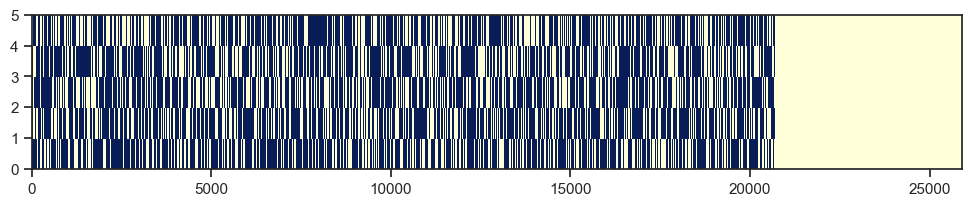

In [18]:
# И визуализируем (синим цветом показаны данные, которые попали в обучающую выборку)
fig, ax = plt.subplots(figsize=(12,2))
ax.pcolor(bin_array, cmap='YlGnBu')
plt.show()

In [19]:
# Оценим Out-of-bag error, теоретическое значение 37%
for i in range(5):
    cur_data = bin_array[i]
    len_cur_data = len(cur_data)
    sum_cur_data = sum(cur_data)
    (len(bin_array[0]) - sum(bin_array[0])) / len(bin_array[0])
    oob_i = (len_cur_data - sum_cur_data) / len_cur_data
    print('Для модели № {} размер OOB составляет {}%'.format(i+1, round(oob_i, 4)*100.0))

Для модели № 1 размер OOB составляет 49.559999999999995%
Для модели № 2 размер OOB составляет 49.69%
Для модели № 3 размер OOB составляет 49.38%
Для модели № 4 размер OOB составляет 49.5%
Для модели № 5 размер OOB составляет 49.230000000000004%


In [20]:
# Out-of-bag error, возвращаемый классификатором
# Для классификации используется метрика accuracy
bag.oob_score_, 1-bag.oob_score_

(0.8970261658781501, 0.1029738341218499)

In [21]:
Image(get_png_tree(bag.estimators_[0], dataset.iloc[:, :-1].columns), width="100%")

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.949245 to fit



In [22]:
# Image(get_png_tree(bag.estimators_[1], dataset.iloc[:, :-1].columns), width="100%")

In [23]:
# Image(get_png_tree(bag.estimators_[2], dataset.iloc[:, :-1].columns), width="100%")

In [24]:
from operator import itemgetter

def draw_feature_importances(tree_model, X_dataset, figsize=(18,5)):
    """
    Вывод важности признаков в виде графика
    """
    # Сортировка значений важности признаков по убыванию
    list_to_sort = list(zip(X_dataset.columns.values, tree_model.feature_importances_))
    sorted_list = sorted(list_to_sort, key=itemgetter(1), reverse = True)
    # Названия признаков
    labels = [x for x,_ in sorted_list]
    # Важности признаков
    data = [x for _,x in sorted_list]
    # Вывод графика
    fig, ax = plt.subplots(figsize=figsize)
    ind = np.arange(len(labels))
    plt.bar(ind, data)
    plt.xticks(ind, labels, rotation='vertical')
    # Вывод значений
    for a,b in zip(ind, data):
        plt.text(a-0.05, b+0.01, str(round(b,3)))
    plt.show()
    return labels, data

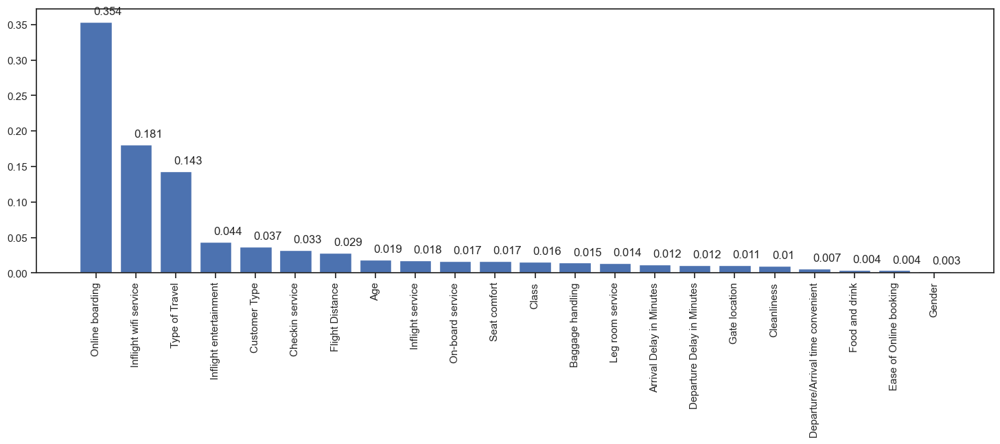

In [25]:
fl, fd = draw_feature_importances(bag.estimators_[0], dataset.iloc[:, :-1])
# fl, fd = draw_feature_importances(bag.estimators_[1], dataset.iloc[:, :-1])
# fl, fd = draw_feature_importances(bag.estimators_[2], dataset.iloc[:, :-1])
# fl, fd = draw_feature_importances(bag.estimators_[3], dataset.iloc[:, :-1])
# fl, fd = draw_feature_importances(bag.estimators_[4], dataset.iloc[:, :-1])

In [26]:
y_pred_test_bag = bag.predict(X_test)
y_pred_train_bag = bag.predict(X_train)
ac_bag = accuracy_score(y_train, y_pred_train_bag), accuracy_score(y_test, y_pred_test_bag)
ac_bag

(0.9940137105339384, 0.9469009461285962)

In [27]:
boost = GradientBoostingClassifier(n_estimators=5, random_state=1).fit(X_train, y_train)
y_pred_test_boost = boost.predict(X_test)
y_pred_train_boost = boost.predict(X_train)
ac_boost = accuracy_score(y_train, y_pred_train_boost), accuracy_score(y_test, y_pred_test_boost)
ac_boost

(0.8910881529400405, 0.8916779301023363)

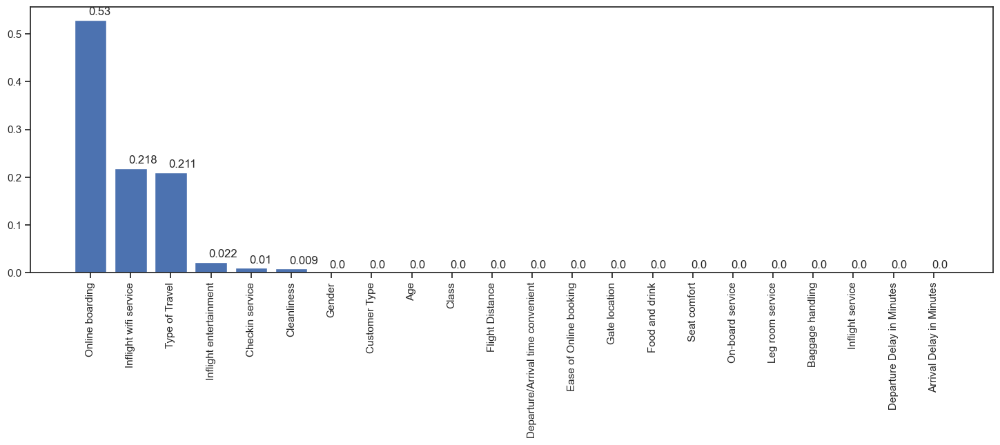

In [28]:
fl, fd = draw_feature_importances(boost, dataset.iloc[:, :-1])

In [29]:
from catboost import CatBoostClassifier, Pool

cat = CatBoostClassifier(iterations=5,
                           depth=2,
                           learning_rate=1,
                           loss_function='Logloss',
                           verbose=True)
cat.fit(X_train, y_train)

y_pred_test_cat = cat.predict(X_test)
y_pred_train_cat = cat.predict(X_train)
ac_cat = accuracy_score(y_train, y_pred_train_cat), accuracy_score(y_test, y_pred_test_cat)
ac_cat

0:	learn: 0.4146353	total: 67.9ms	remaining: 272ms
1:	learn: 0.3223490	total: 74.5ms	remaining: 112ms
2:	learn: 0.2656814	total: 80.4ms	remaining: 53.6ms
3:	learn: 0.2446246	total: 88.2ms	remaining: 22ms
4:	learn: 0.2313017	total: 102ms	remaining: 0us


(0.915516076083808, 0.9148484263371307)

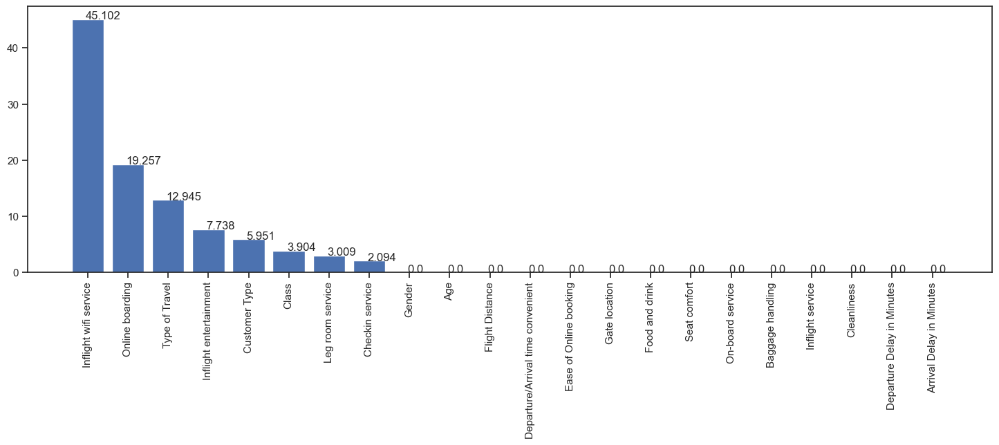

In [30]:
fl, fd = draw_feature_importances(cat, dataset.iloc[:, :-1])

In [31]:
# Качество отдельных моделей
def val_acc(model):
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    result = accuracy_score(y_test, y_pred)
    print(model)
    print('Accuracy={}'.format(result))

In [32]:
# Точность на отдельных моделях
for model in [
    LogisticRegression(),
    DecisionTreeClassifier(random_state=1),
    BaggingClassifier(n_estimators=5)
]:
    val_acc(model)
    print('==========================')
    print()

LogisticRegression()
Accuracy=0.8140567677157753

DecisionTreeClassifier(random_state=1)
Accuracy=0.937246572697432

BaggingClassifier(n_estimators=5)
Accuracy=0.9445838965051169



In [33]:
# Используем библиотеку heamy
# набор данных
dataset = Dataset(X_train, y_train, X_test)

# модели первого уровня
model_tree = Classifier(dataset=dataset, estimator=DecisionTreeClassifier, parameters={'random_state': 1}, name='tree')
model_lr = Classifier(dataset=dataset, estimator=LogisticRegression,name='lr')
model_bag = Classifier(dataset=dataset, estimator=BaggingClassifier, parameters={'n_estimators': 5},name='bag')

In [34]:
# # Эксперимент 1
# # Первый уровень - две модели: дерево и логистическая регрессия
# # Второй уровень: логистическая регрессия

# pipeline = ModelsPipeline(model_tree, model_lr)
# stack_ds = pipeline.stack(k=10, seed=1)
# # модель второго уровня
# stacker = Classifier(dataset=stack_ds, estimator=LogisticRegression)
# results = stacker.validate(k=10,scorer=accuracy_score)

In [35]:
# # Эксперимент 2
# # Первый уровень - две модели: дерево и логистическая регрессия
# # Второй уровень: бэгги3нг

# stacker = Classifier(dataset=stack_ds, estimator=BaggingClassifier, parameters={'n_estimators': 5}, use_cache=False)
# results = stacker.validate(k=10,scorer=log_loss)

In [36]:
# Эксперимент 1
# Первый уровень - две модели: дерево и логистическая регрессия
# Второй уровень: логистическая регрессия
clf1_1 = DecisionTreeClassifier(random_state=1)
clf1_2 = LogisticRegression()
sclf1 = StackingClassifier(classifiers=[clf1_1, clf1_2], meta_classifier = clf1_2)

for clf, label in zip([clf1_1, clf1_2, sclf1], ['Tree', 'Logistic', 'Stacking']):
    clf.fit(X_train, y_train)
    y_stack_predict = clf.predict(X_test)
    print("Accuracy score: %0.10f [%s]" % (accuracy_score(y_test, y_stack_predict), label))

Accuracy score: 0.9372465727 [Tree]
Accuracy score: 0.8140567677 [Logistic]
Accuracy score: 0.9372465727 [Stacking]


In [37]:
# Эксперимент 2
# Первый уровень - две модели: дерево и логистическая регрессия
# Второй уровень: бэггинг
clf2_1 = DecisionTreeClassifier(random_state=1)
clf2_2 = LogisticRegression()
clf2_3 = BaggingClassifier(n_estimators=5, oob_score=True, random_state=1)
sclf2 = StackingClassifier(classifiers=[clf2_1, clf2_2], meta_classifier = clf2_3)

for clf, label in zip([clf2_1, clf2_2, sclf2], ['Tree', 'Logistic', 'Stacking']):
    clf.fit(X_train, y_train)
    y_stack_predict = clf.predict(X_test)
    print("Accuracy score: %0.10f [%s]" % (accuracy_score(y_test, y_stack_predict), label))

Accuracy score: 0.9372465727 [Tree]
Accuracy score: 0.8140567677 [Logistic]
Accuracy score: 0.9372465727 [Stacking]


In [38]:
# Эксперимент 3
# Первый уровень - три модели: дерево, логистическое регрессия и бэггенг
# Второй уровень: логистическая регрессия
clf3_1 = DecisionTreeClassifier(random_state=1)
clf3_2 = LogisticRegression()
clf3_3 = BaggingClassifier(n_estimators=5, oob_score=True, random_state=1)
sclf3 = StackingClassifier(classifiers=[clf3_1, clf3_2, clf3_3], meta_classifier = clf3_2)

for clf, label in zip([clf3_1, clf3_2, clf3_3, sclf3], ['Tree', 'Logistic', 'Bagging', 'Stacking']):
    clf.fit(X_train, y_train)
    y_stack_predict = clf.predict(X_test)
    print("Accuracy score: %0.10f [%s]" % (accuracy_score(y_test, y_stack_predict), label))

Accuracy score: 0.9372465727 [Tree]
Accuracy score: 0.8140567677 [Logistic]
Accuracy score: 0.9469009461 [Bagging]
Accuracy score: 0.9372465727 [Stacking]


In [39]:
# Эксперимент 4
# Первый уровень - три модели: дерево, логистическое регрессия и бэггенг
# Второй уровень: бэггенг
clf4_1 = DecisionTreeClassifier(random_state=1)
clf4_2 = LogisticRegression()
clf4_3 = BaggingClassifier(n_estimators=5, oob_score=True, random_state=1)
sclf4 = StackingClassifier(classifiers=[clf4_1, clf4_2, clf4_3], meta_classifier = clf4_3)

for clf, label in zip([clf4_1, clf4_2, clf4_3, sclf4], ['Tree', 'Logistic', 'Bagging', 'Stacking']):
    clf.fit(X_train, y_train)
    y_stack_predict = clf.predict(X_test)
    print("Accuracy score: %0.10f [%s]" % (accuracy_score(y_test, y_stack_predict), label))

Accuracy score: 0.9372465727 [Tree]
Accuracy score: 0.8140567677 [Logistic]
Accuracy score: 0.9469009461 [Bagging]
Accuracy score: 0.9372465727 [Stacking]


In [40]:
# Эксперимент 5
# Первый уровень - две модели: логистическое регрессия и бэггенг
# Второй уровень: дерево
clf5_1 = DecisionTreeClassifier(random_state=1)
clf5_2 = LogisticRegression()
clf5_3 = BaggingClassifier(n_estimators=5, oob_score=True, random_state=1)
sclf5 = StackingClassifier(classifiers=[clf5_3, clf5_2], meta_classifier = clf5_1)

for clf, label in zip([clf5_1, clf5_2, clf5_3, sclf5], ['Tree', 'Logistic', 'Bagging', 'Stacking']):
    clf.fit(X_train, y_train)
    y_stack_predict = clf.predict(X_test)
    print("Accuracy score: %0.10f [%s]" % (accuracy_score(y_test, y_stack_predict), label))

Accuracy score: 0.9372465727 [Tree]
Accuracy score: 0.8140567677 [Logistic]
Accuracy score: 0.9469009461 [Bagging]
Accuracy score: 0.9469009461 [Stacking]


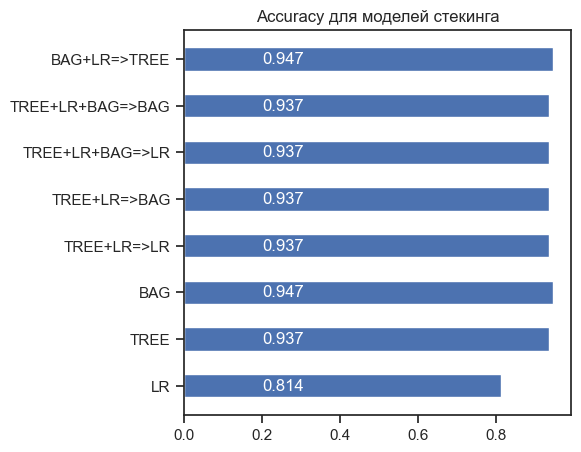

In [41]:
def vis_models_quality(array_metric, array_labels, str_header, figsize=(5, 5)):
    fig, ax1 = plt.subplots(figsize=figsize)
    pos = np.arange(len(array_metric))
    rects = ax1.barh(pos, array_metric,
                     align='center',
                     height=0.5, 
                     tick_label=array_labels)
    ax1.set_title(str_header)
    for a,b in zip(pos, array_metric):
        plt.text(0.2, a-0.1, str(round(b,3)), color='white')
    plt.show()

# Результаты
array_labels = ['LR','TREE', 'BAG', 'TREE+LR=>LR', 
                'TREE+LR=>BAG', 'TREE+LR+BAG=>LR', 'TREE+LR+BAG=>BAG', 'BAG+LR=>TREE']
array_acc = [0.8140567677, 0.9372465727, 0.9469009461, 
             0.9372465727, 0.9372465727, 0.9372465727, 
             0.9372465727, 0.9469009461]
# Визуализация результатов
vis_models_quality(array_acc, array_labels, 'Accuracy для моделей стекинга')

In [42]:
from sklearn.neural_network import MLPClassifier

mlp = MLPClassifier(random_state=1, max_iter=300).fit(X_train, y_train)
y_pred_test_mlp = mlp.predict(X_test)
y_pred_train_mlp = mlp.predict(X_train)
ac_mlp = accuracy_score(y_train, y_pred_train_mlp), accuracy_score(y_test, y_pred_test_mlp)
ac_mlp

(0.7454378681085256, 0.7431936667310292)

In [43]:
mlp = MLPClassifier(random_state=1, max_iter=300, solver='adam', 
                    hidden_layer_sizes=(100, 5)).fit(X_train, y_train)
y_pred_test_mlp = mlp.predict(X_test)
y_pred_train_mlp = mlp.predict(X_train)
ac_mlp = accuracy_score(y_train, y_pred_train_mlp), accuracy_score(y_test, y_pred_test_mlp)
ac_mlp

(0.9263300183450807, 0.9275921992662676)

In [49]:
from gmdhpy import gmdh

gmd = gmdh.Classifier().fit(X_train, y_train, validation_data=(X_test, y_test))

train layer0 in 4.57 sec
train layer1 in 29.45 sec
train layer2 in 28.97 sec
train layer3 in 33.12 sec
train layer4 in 25.04 sec
train layer5 in 26.41 sec
train layer6 in 24.17 sec
train layer7 in 23.36 sec
train layer8 in 23.35 sec


In [50]:
y_pred_test_gmdh = gmd.predict_proba(X_test)
y_pred_train_gmdh = gmd.predict_proba(X_train)

for i in range(len(y_pred_test_gmdh)):
    if y_pred_test_gmdh[i] >= 0.5:
        y_pred_test_gmdh[i] = 1
    else:
        y_pred_test_gmdh[i] = 0

for i in range(len(y_pred_train_gmdh)):
    if y_pred_train_gmdh[i] >= 0.5:
        y_pred_train_gmdh[i] = 1
    else:
        y_pred_train_gmdh[i] = 0

ac_gmdh = accuracy_score(y_train, y_pred_train_gmdh), accuracy_score(y_test, y_pred_test_gmdh)
ac_gmdh

(0.8687843970261658, 0.8683143463989187)